# **Credit Card Fraud Detection**

![logo](images/credit-card-fraud-detection.webp)

## Introdução

O objetivo deste projeto é desenvolver um modelo de *Machine Learning* capaz de identificar transações fraudulentas em cartões de crédito. Usando informações disponíveis, o modelo aprenderá a diferenciar as transações legítimas das fraudulentas.

O modelo vai ser desenvolvido utilizando a linguagem **Python** e vai ser testado e treinado com dados de um *dataset* disponível no [Kaggle](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud).

A abordagem realizada seguirá a metodologia **CRISP-DM** (Cross-Industry Standard Process for Data Mining), que inclui as seguintes etapas: compreensão do tema, compreensão dos dados, preparação dos dados, modelação e avaliação.

## Estrutura do Projeto

O projeto é composto por:

- **task1.py**: código desenvolvido para a compreensão do tema e dos dados e para a preparação dos dados.
- **task2.py**: código desenvolvido para a modelação e avaliação dos modelos.
- **task3.py**: código desenvolvido para a competição kaggle.
- images: pasta com as imagens utilizadas no projeto.
- CreditCardFraudDetection: pasta com o *dataset* utilizado no projeto.

## Tecnologias Utilizadas

Como já foi referido, a linguagem de programação utilizada será o *Python* e as bibliotecas utilizadas foram:

- *Matplotlib* e *Seaborn* para visualização dos dados;
- *Pandas* para manipulação dos dados;
- *NumPy* para tratar os dados númericos;
- *Scikit-learn* para desenvolver o modelo de *Machine Learning*.

In [1]:
import matplotlib.pyplot as plt
import seaborn as sb
import pandas as pd
import numpy as np
import folium

from scipy.stats import chi2_contingency
from datetime import datetime
from sklearn.model_selection import train_test_split
from scipy.stats import shapiro
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import DBSCAN
from sklearn.manifold import TSNE

import warnings
%matplotlib inline
warnings.filterwarnings('ignore')

## Compreensão do Tema
 
Os cartões de crédito são atualmente um dos meios de pagamento mais adotados, especialmente com a expansão do comércio online. Contudo, essa evolução aumentou a exposição dos utilizadores a fraudes, sendo a segurança um aspeto essencial tanto para as instituições financeiras quanto para os consumidores.

Este problema tem como objetivo prever se uma transação de cartão de crédito é **legítima** ou **fraudulenta**, utilizando um *dataset*. A necessidade principal é identificar transações ilegítimas com precisão, de forma a prevenir impactos negativos financeiros.

O objetivo do modelo consiste em classificar cada transação num dos dois grupos mutuamente exclusivos:
- **Legítima**: Transação autorizada, realizada pelo titular do cartão.
- **Fraudulenta**: Transação não autorizada, efetuada por terceiros.

Para abordar o problema, será desenvolvido um modelo de *machine learning* especializado em classificação binária, capaz de distinguir transações legítimas das fraudulentas com alto grau de precisão. 

O modelo será treinado utilizando uma abordagem de *supervised learning*, com a meta de alcançar uma alta taxa de precisão e recall nos dados de teste, assegurando eficácia prática e capacidade de minimizar falsos positivos e falsos negativos na deteção de fraudes.

## Compreensão dos Dados

Antes de começar a compreender os dados, é necessário importar os vários ficheiros e juntá-los num único *dataset*.

In [2]:
cities = pd.read_csv('CreditCardTransactions/cities.csv')
customers = pd.read_csv('CreditCardTransactions/customers.csv')
merchants = pd.read_csv('CreditCardTransactions/merchants.csv')
transactions = pd.read_csv('CreditCardTransactions/transactions.csv')

# Merge do customers.csv e cities.csv usando 'city'
customers_cities = pd.merge(customers, cities, on='city', how='left')

# Merge do transactions.csv e customers_cities usando 'cc_num'
transactions_customers = pd.merge(transactions, customers_cities, on='cc_num', how='left')

# Merge final do transactions_customers e merchants.csv usando 'merchant'
final_data = pd.merge(transactions_customers, merchants, on='merchant', how='left')

# Guardar o resultado final
final_data.to_csv('CreditCardTransactions/merged_dataset.csv', index=False)

data = pd.read_csv('CreditCardTransactions/merged_dataset.csv')

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   index                  30000 non-null  int64  
 1   trans_date_trans_time  29900 non-null  object 
 2   cc_num                 30000 non-null  int64  
 3   device_os              12036 non-null  object 
 4   merchant               30000 non-null  object 
 5   amt                    29900 non-null  float64
 6   trans_num              30000 non-null  object 
 7   unix_time              30000 non-null  int64  
 8   is_fraud               30000 non-null  int64  
 9   first                  29990 non-null  object 
 10  last                   29990 non-null  object 
 11  gender                 29990 non-null  object 
 12  street                 29990 non-null  object 
 13  city                   29990 non-null  object 
 14  zip                    29784 non-null  float64
 15  jo

O *dataset* é constituído por **30000** entradas e **25** colunas. Cada entrada representa uma transação de cartão de crédito. As colunas contêm informações sobre a transação, como o valor, a data, a localização, entre outros que vamos ver com detalhe mais à frente.

In [3]:
data.head()

,index,trans_date_trans_time,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,first,...,job,dob,lat,long,city_pop,state,category,merch_lat,merch_long,merchant_id
0,5381,2023-01-01 00:39:03,2801374844713453,NaN,Merchant_85,252.75,TRANS_662964,1672533543,0,Jane,...,NaN,2002-10-12,41.8781,-87.6298,2716000.0,IL,NaN,NaN,76.433212,85.0
1,4008,2023-01-01 01:16:08,3460245159749480,NaN,Merchant_23,340.17,TRANS_134939,1672535768,0,Alice,...,Nurse,2001-12-23,40.7128,-74.0060,8419600.0,NY,Entertainment,27.177588,-64.857435,23.0
2,1221,2023-01-01 01:24:28,7308701990157768,macOS,Merchant_70,76.38,TRANS_258923,1672536268,0,Bob,...,Doctor,1978-12-13,33.4484,-112.0740,1680992.0,AZ,Electronics,31.730070,-67.777407,70.0
3,9609,2023-01-01 02:06:57,8454886440761098,X11,Merchant_33,368.88,TRANS_226814,1672538817,0,Mike,...,Teacher,1965-04-21,33.4484,-112.0740,1680992.0,AZ,Electronics,-5.005953,146.873847,33.0
4,5689,2023-01-01 02:10:54,6350332939133843,NaN,Merchant_90,323.32,TRANS_668449,1672539054,0,Mike,...,Nurse,1997-05-17,40.7128,-74.0060,8419600.0,NY,Groceries,79.065894,40.668693,90.0


Assim, vamos analisar com mais detalhe os atributos do *dataset*.

| **Atributo**            | **Tipo e Escala**        | **Significado**                                                  |
|--------------------------|-------------------------|-------------------------------------------------------------------|
| `index`                  | Categório Nominal  | Identificador único para cada linha do dataset                |
| `trans_date_trans_time`  | Numérico Intervalo  | Data e hora da transação                           |
| `cc_num`                 | Categório Nominal  | Número do cartão de crédito utilizado na transação               |
| `device_os`              | Categórico Nominal     | Sistema operativo do dispositivo utilizado para a transação    |
| `merchant`               | Categórico Nominal     | Nome/Identificador do comerciante                             |
| `amt`                    | Numérico Ratio     | Valor da transação (em unidades monetárias)                      |
| `trans_num`              | Categórico Nominal    | Identificador único para cada transação                          |
| `unix_time`              | Numérico Intervalo    | Timestamp Unix que representa a data e hora da transação         |
| `is_fraud`               | Categório Nominal     | Indicador de fraude na transação (`0`: Não fraudulenta, `1`: Fraudulenta) |
| `first` e `last`         | Categórico Nominal     | Primeiro e último nome do titular do cartão                      |
| `gender`                 | Categórico Nominal     | Género do titular do cartão                                       |
| `street`                 | Categórico Nominal     | Nome da rua                                                      |
| `city`                   | Categórico Nominal     | Cidade do cliente                                                |
| `zip`                    | Categório Nominal   | Código postal                                                    |
| `state`                  | Categórico Nominal     | Estado                                                           |
| `job`                    | Categórico Nominal     | Profissão do titular do cartão                                   |
| `dob`                    | Categórico Ordinal | Data de nascimento do titular do cartão                          |
| `lat` e `long`           | Numérico Intervalo     | Latitude e longitude da localização do cliente                   |
| `city_pop`               | Numérico Ratio     | População da cidade onde o cliente reside                        |
| `category`               | Categórico Nominal     | Categoria do comerciante                                         |
| `merch_lat` e `merch_long`| Numérico Intervalo     | Latitude e longitude do comerciante                              |
| `merchant_id`            | Categórico Nominal   | Identificador único do comerciante                               |

Os atributos **device_os**, **amt**, **unix_time**/**trans_data_trans_time**, **gender**, **job**, **category**, **city**, **cc_num**, **merchant**/**merchant_id**, **trans_num** e **dob** parecem ser os mais relevantes para detetar fraude, pois parecem ter mais relação com a variável alvo **is_fraud**. Estes serão mais analisados e tratados nas próximas etapas.

Existem, também, vários atributos relacionados com a localização, como por exemplo, **lat**, **long**, **city_pop**, **zip**, **state**, **street**, **merch_lat** e **merch_long**. Estes atributos podem ser úteis para o modelo, contudo é necessário analisar a relevância e a correlação com a variável alvo e perceber se são todos necessários, pois parecem ser redundantes quando usados em conjunto.

Em contrapartida, os atributos **index**, **first** e **last** são irrelevantes para o modelo, pois são identificadores únicos/informações que não têm relação com a variável alvo. Deverão, portanto, ser removidos numa próxima etapa.

In [4]:
data.dtypes

index                      int64
trans_date_trans_time     object
cc_num                     int64
device_os                 object
merchant                  object
amt                      float64
trans_num                 object
unix_time                  int64
is_fraud                   int64
first                     object
last                      object
gender                    object
street                    object
city                      object
zip                      float64
job                       object
dob                       object
lat                      float64
long                     float64
city_pop                 float64
state                     object
category                  object
merch_lat                float64
merch_long               float64
merchant_id              float64
dtype: object

Alguns atributos são reconhecidos como numéricos pelo **Python**, mas devem ser tratados como categóricos. Por isso, é necessário convertê-los para o tipo adequado.

In [5]:
data['index'] = data['index'].astype('object')
data['cc_num'] = data['cc_num'].astype('object')
data['is_fraud'] = data['is_fraud'].astype('object')
data['zip'] = data['zip'].astype('object')
data['merchant_id'] = data['merchant_id'].astype('object')

Para sumarizar os dados foram calculadas algumas estatística das variáveis que parecem ter maior relevância para a deteção de fraude.

Os valores médios das transações fraudulentas (253.25) e não fraudulentas (250.00) são muito próximos, o que indica que o montante médio não é, por si só, um indicador significativo de fraude. No entanto, a análise dos quartis revela uma leve tendência das transações fraudulentas terem valores um pouco mais altos, como evidenciado pela mediana, que é ligeiramente maior nos casos fraudes (256.65 contra 249.53).

Outro ponto relevante é o desvio padrão das transações. As fraudulentas possuem um desvio padrão ligeiramente menor (138.69), sugerindo que os valores de fraudes são menos variados e mais concentrados. Além disso, os valores mínimos das fraudes (2.39) são maiores do que os das transações não fraudulentas (1.01), indicando que transações fraudulentas tendem a não ocorrer em valores extremamente baixos.

A seguir, apresentamos um gráfico de bigodes que ilustra de forma clara as observações mencionadas, destacando as pequenas diferenças entre transações fraudulentas e não fraudulentas na variável **amt**.

In [6]:
fraud_stats = {
    'Não Fraude': data[data['is_fraud'] == 0]['amt'].describe(),
    'Fraude': data[data['is_fraud'] == 1]['amt'].describe()
}

fraud_stats_df = pd.DataFrame(fraud_stats)
print(fraud_stats_df)

         Não Fraude      Fraude
count  29331.000000  569.000000
mean     250.001425  253.252179
std      144.210626  138.693670
min        1.010000    2.390000
25%      125.100000  132.010000
50%      249.530000  256.650000
75%      375.425000  369.800000
max      499.970000  499.520000


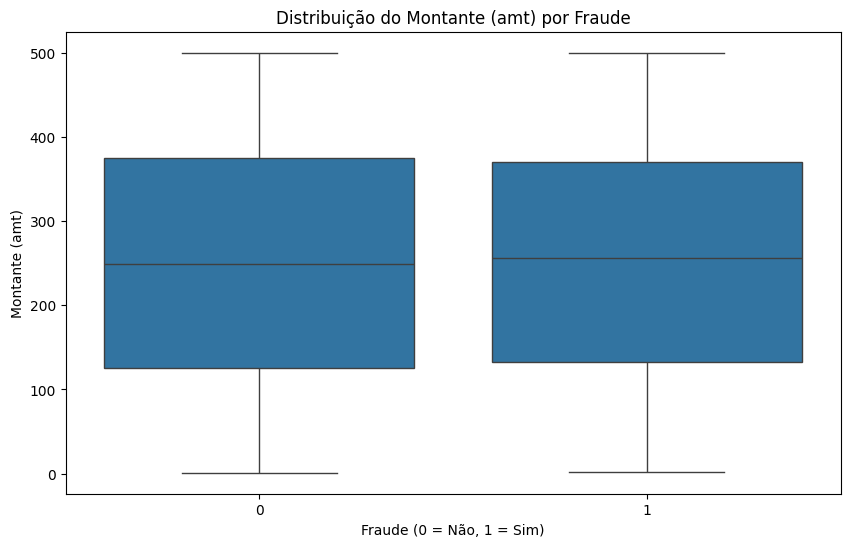

In [7]:
plt.figure(figsize=(10, 6))
sb.boxplot(x=data['is_fraud'], y=data['amt'], data=data) 
plt.title('Distribuição do Montante (amt) por Fraude')
plt.xlabel('Fraude (0 = Não, 1 = Sim)')
plt.ylabel('Montante (amt)')

plt.show()

A incidência de casos de fraude é relativamente baixa, com uma média de 0.019, o que sugere que aproximadamente 1.9% das transações são fraudulentas. Isto revela que o *dataset* não é equilibrado, pois contém poucas transações fraudulentas em comparação com as legítimas.

In [8]:
data['is_fraud'].mean()

0.019033333333333333

A análise mostra que a distribuição do **unix_time** é muito similar entre fraudes e não fraudes. As medianas, os quartis e os limites extremos são praticamente idênticos.

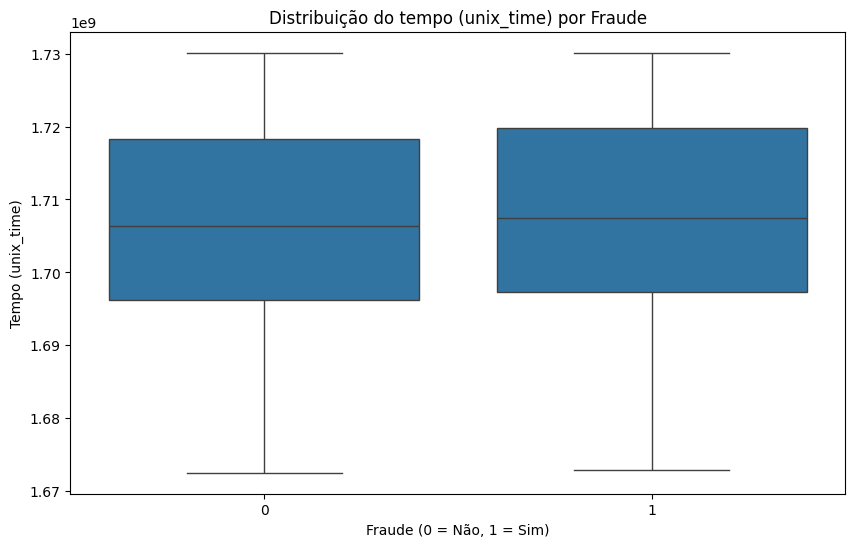

In [9]:
plt.figure(figsize=(10, 6))
sb.boxplot(x=data['is_fraud'], y=data['unix_time'], data=data) 
plt.title('Distribuição do tempo (unix_time) por Fraude')
plt.xlabel('Fraude (0 = Não, 1 = Sim)')
plt.ylabel('Tempo (unix_time)')

plt.show()

Para explorar melhor esta variável, pode ser útil analisá-la em mais detalhe, como dias da semana e horários.

A diferença na quantidade de fraudes entre dias úteis e finais de semana é perceptível. Dias úteis apresentam consistentemente mais fraudes, ao contrário dos fins de semana que têm uma redução significativa. Os dias com mais fraudes são segunda, seguida de terça e sexta.

In [10]:
# Criar uma nova coluna 'day_of_week' com o dia da semana da transação
data_copy = data.copy()
data_copy['trans_date_trans_time'] = pd.to_datetime(data_copy['unix_time'], unit='s')

data_copy['day_of_week'] = data_copy['trans_date_trans_time'].dt.day_name()

fraud_table = data_copy.groupby(['day_of_week', 'is_fraud']).size().unstack(fill_value=0)
fraud_table.columns = ['Não Fraude', 'Fraude']

# Visualizar
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fraud_table = fraud_table.reindex(ordered_days, fill_value=0)

fraud_table = fraud_table.sort_values(by='Fraude', ascending=False)

print(fraud_table)

             Não Fraude  Fraude
day_of_week                    
Monday             4315      93
Tuesday            4169      92
Friday             4162      92
Thursday           4251      86
Wednesday          4081      77
Saturday           4242      71
Sunday             4209      60


A análise revela que a manhã apresenta a maior taxa de fraudes (2.05%), seguida pela noite (1.99%), enquanto a madrugada (1.85%) e a tarde (1.75%) têm taxas ligeiramente menores.

Contudo, é durante a madrugada que se observa o maior volume de transações, o que resulta também no maior número absoluto de fraudes, apesar da taxa de fraude ser inferior à da manhã e da noite. Isso sugere que, embora o risco proporcional seja menor nesse período, a maior atividade torna a madrugada particularmente relevante.

In [11]:
# Criar uma nova coluna 'hour' com a hora da transação
temp_data = data.copy()

temp_data['datetime'] = pd.to_datetime(temp_data['unix_time'], unit='s')
temp_data['hour'] = temp_data['datetime'].dt.hour

# Definir o período do dia
def categorize_period(hour):
    if 0 <= hour < 8:
        return 'Madrugada'
    elif 8 <= hour < 13:
        return 'Manhã'
    elif 13 <= hour < 18:
        return 'Tarde'
    else:
        return 'Noite'

temp_data = temp_data.assign(
    period_of_day=temp_data['hour'].apply(categorize_period)
)

# Estatísticas por período do dia
period_stats = temp_data.groupby('period_of_day')['is_fraud'].agg(
    total_frauds='sum',
    total_transactions='count',
    fraud_rate=lambda x: x.sum() / len(x) * 100  
).reset_index()

for _, row in period_stats.iterrows():
    print(f"Period of Day: {row['period_of_day']}")
    print(f"  Total Frauds: {row['total_frauds']}")
    print(f"  Total Transactions: {row['total_transactions']}")
    print(f"  Fraud Rate: {row['fraud_rate']:.2f}%")
    print("-" * 30)

Period of Day: Madrugada
  Total Frauds: 186
  Total Transactions: 10074
  Fraud Rate: 1.85%
------------------------------
Period of Day: Manhã
  Total Frauds: 128
  Total Transactions: 6259
  Fraud Rate: 2.05%
------------------------------
Period of Day: Noite
  Total Frauds: 149
  Total Transactions: 7500
  Fraud Rate: 1.99%
------------------------------
Period of Day: Tarde
  Total Frauds: 108
  Total Transactions: 6167
  Fraud Rate: 1.75%
------------------------------


A variação nas taxas de fraude entre as cidades não é muito grande (1,351% a 1,998%), mas cidades como *Test City* e *Chicago* destacam-se por estarem consistentemente acima da média geral.

In [12]:
data.groupby('city')['is_fraud'].mean().sort_values(ascending=False)

city
Test City       0.01998
Chicago        0.019392
Phoenix        0.018344
Houston        0.017751
Los Angeles    0.016506
New York       0.013506
Name: is_fraud, dtype: object

O maior índice de fraudes em *macOS* e *windows* pode estar relacionado com as características específicas desses sistemas ou com o perfil do atacante. Apesar do *Linux* e *Windows* apresentarem taxas mais baixas, a diferença não é significativa.

In [13]:
data.groupby('device_os')['is_fraud'].sum().sort_values(ascending=False)

device_os
macOS      69
other      63
Windows    62
X11        32
Linux      28
Name: is_fraud, dtype: object

*Groceries* tem a maior taxa de fraudes (2,06%), seguida do *Entertainment* (2,02%) e *Apparel* (1,98%).
As diferenças entre as taxas de fraude por categoria são relativamente pequenas, variando entre 1,73% e 2,06%.

In [14]:
data.groupby('category')['is_fraud'].mean().sort_values(ascending=False)

category
Groceries        0.020576
Entertainment    0.020163
Apparel          0.019774
Electronics      0.018179
Travel           0.017302
Name: is_fraud, dtype: object

*Clerk* (2,19%) apresenta a maior taxa de fraude, seguido de *Lawyer* (2,05%) e *Doctor* (1,83%).
As taxas de fraude por profissão variam entre 1,63% e 2,19%, com diferenças relativamente pequenas, mas ainda assim podem ser relevantes para identificar padrões.

In [15]:
data.groupby('job')['is_fraud'].mean().sort_values(ascending=False)

job
Clerk       0.021894
Lawyer      0.020487
Doctor      0.018364
Engineer    0.017801
Artist      0.017517
Teacher     0.017404
Nurse        0.01626
Name: is_fraud, dtype: object

Embora a diferença não seja muito grande, há um número maior de fraudes relacionadas a indivíduos do género feminino.

In [16]:
data.groupby('gender')['is_fraud'].sum().sort_values(ascending=False)

gender
F    300
M    271
Name: is_fraud, dtype: object

A análise por faixa etária mostra que os jovens adultos apresentam a maior taxa de fraude (2.06%), seguidos pelos adultos (1.94%) e pela faixa de meia-idade (1.76%). Curiosamente, os seniores registraram um número quase insignificante de transações (10) e nenhuma fraude. Apesar disso, devido ao maior volume de transações, os adultos e a faixa de meia-idade concentram o maior número absoluto de fraudes.

In [17]:
# Calcular as faixas etárias 
def categorize_age(dob):
    today = datetime.today()
    age = today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
    if 17 <= age <= 36:
        return 'Young Adult'
    elif 37 <= age <= 55:
        return 'Adult'
    elif 56 <= age <= 74:
        return 'Middle Age'
    else:
        return 'Senior'

# Estatísticas
fraud_stats = data.assign(
    dob=pd.to_datetime(data['dob']),
    age=lambda df: df['dob'].apply(
        lambda dob: datetime.today().year - dob.year - ((datetime.today().month, datetime.today().day) < (dob.month, dob.day))
    ),  # Calcular a idade
    age_category=lambda df: df['dob'].apply(categorize_age)
).groupby('age_category').agg(
    total_frauds=('is_fraud', 'sum'),
    total_transactions=('is_fraud', 'count'),
    fraud_rate=('is_fraud', lambda x: x.sum() / len(x) * 100),
    min_age=('age', 'min'),
    max_age=('age', 'max')
).reset_index()

for _, row in fraud_stats.iterrows():
    print(f"Age Category: {row['age_category']}")
    print(f"  Total Frauds: {row['total_frauds']}")
    print(f"  Total Transactions: {row['total_transactions']}")
    print(f"  Fraud Rate: {row['fraud_rate']:.2f}%")
    print(f"  Min Age: {row['min_age']}")
    print(f"  Max Age: {row['max_age']}")
    print("-" * 40)


Age Category: Adult
  Total Frauds: 192
  Total Transactions: 9875
  Fraud Rate: 1.94%
  Min Age: 37.0
  Max Age: 55.0
----------------------------------------
Age Category: Middle Age
  Total Frauds: 209
  Total Transactions: 11849
  Fraud Rate: 1.76%
  Min Age: 56.0
  Max Age: 74.0
----------------------------------------
Age Category: Senior
  Total Frauds: 0
  Total Transactions: 10
  Fraud Rate: 0.00%
  Min Age: nan
  Max Age: nan
----------------------------------------
Age Category: Young Adult
  Total Frauds: 170
  Total Transactions: 8266
  Fraud Rate: 2.06%
  Min Age: 18.0
  Max Age: 36.0
----------------------------------------


Podemos verificar que existe uma incidência de fraude bastante superior nalguns **merchants** em comparação com outros. Mais à frente, podemos criar variáveis que vão representar a relação dos **comerciantes** com os **clientes**.

In [18]:
data.groupby('merchant')['is_fraud'].sum().sort_values(ascending=False)

merchant
Merchant_38         13
Merchant_76         12
Merchant_58         11
Merchant_45         11
Merchant_62         11
                    ..
Merchant_29          2
Merchant_15          2
Merchant_99          2
Merchant_21          1
Unknown_Merchant     0
Name: is_fraud, Length: 101, dtype: object

Nesta fase da exploração dos dados, vão ser criados alguns gráficos para os atributos considerados mais relevantes, tendo em vista a extração de novas conclusões.

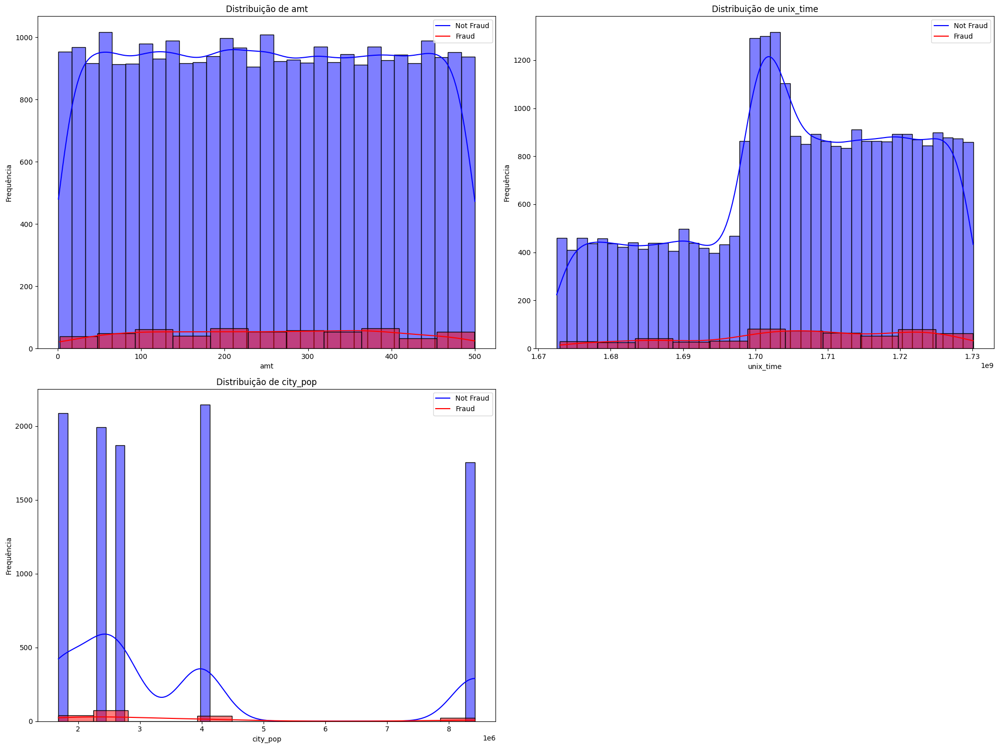

In [19]:
plt.figure(figsize = (20, 15))

is_fraud = data[data['is_fraud'] == 1][['amt', 'unix_time', 'city_pop']]
is_not_fraud = data[data['is_fraud'] == 0][['amt', 'unix_time', 'city_pop']]

# Iterar sobre as colunas numéricas e criar gráficos
for i, col in enumerate(is_fraud.columns):
    plt.subplot(2, 2, i + 1)
    sb.histplot(data=is_not_fraud[col], label='Not Fraud', color='blue', kde=True, alpha=0.5)
    sb.histplot(data=is_fraud[col], label='Fraud', color='red', kde=True, alpha=0.5)
    plt.legend(plt.gca().get_legend_handles_labels()[1])
    plt.title(f"Distribuição de {col}")
    plt.xlabel(col)
    plt.ylabel("Frequência")

plt.tight_layout()
plt.show()

Transações fraudulentas tendem a estar distribuídas ao longo do intervalo de valores **amt**, mas têm picos menores em comparação com transações legítimas.

Seguem o mesmo padrão geral do **horário da transação** que as legítimas, com uma distribuição mais concentrada em torno de certos horários (aumenta consideravelmente em 1.70 na escala do gráfico).

Transações fraudulentas aparecem em cidades com diferentes populações, mas são mais frequentes em cidades pequenas e grandes.

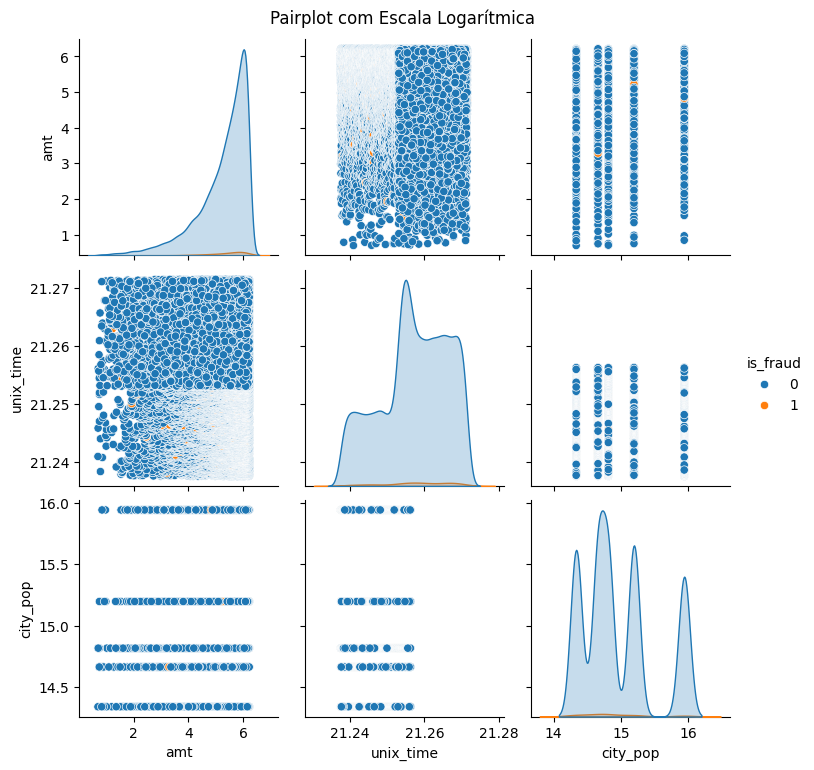

In [20]:
data_log_scaled = data[['amt', 'unix_time', 'city_pop', 'is_fraud']].copy()

# Escala logarítmica
for col in ['amt', 'unix_time', 'city_pop']:
    data_log_scaled[col] = np.log1p(data_log_scaled[col])

# Criar o pairplot
sb.pairplot(data_log_scaled, hue='is_fraud', diag_kind='kde', height=2.5)
plt.suptitle("Pairplot com Escala Logarítmica", y=1.02)
plt.show()

Estes novos gráficos não nos acrescentam mais informação do que aquela que já tínhamos, mas ajudam a reforçar as conclusões anteriores.
Alguns gráficos também não são conclusivos porque como cada ponto no gráfico está concentrado em apenas cinco valores distintos no eixo da população, não há variação suficiente para identificar padrões ou tendências significativas entre as variáveis.

In [21]:
# Criar o mapa sem valores inválidos
mapa = folium.Map(location=[20, 0], zoom_start=2)
mapa_data = data.dropna(subset=['lat', 'long', 'merch_lat', 'merch_long'])

# Adicionar as localizaçoes dos comerciantes
for _, row in mapa_data.iterrows():
    folium.CircleMarker(
        location=[row['merch_lat'], row['merch_long']],
        radius=6,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        popup=f"Comerciante: ({row['merch_lat']}, {row['merch_long']})"
    ).add_to(mapa)

# Adicionar as localizações dos clientes
for _, row in mapa_data.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=6,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.7,
        popup=f"Utilizador: ({row['lat']}, {row['long']})"
    ).add_to(mapa)

mapa

Para entender melhor os valores de latitude e longitude foi criada a visualização acima. Os pontos a **azul** identificam as localizações dos **clientes** e os pontos a **vermelho** as localizações dos **comerciantes**.

A primeira observação que podemos retirar é que existe mais informação da localização dos comerciantes e que existem vários pontos em sítios que não fazem muito sentido, por exemplo, no meio do mar. Podemos concluir que parece que só a latitude e a longitude não nos darão muita informação relevante para a deteção de fraude, mas será interessante combinar estes atributos com outros para perceber se existe alguma relação.

Quando a distância entre os pontos de localização é grande ou inesperada, especialmente num curto intervalo de tempo, pode-se identificar anomalias que indicam possíveis fraudes. Por exemplo, se um utilizador legítimo está localizado numa cidade, mas uma transação ocorre num local muito distante, isso pode sugerir que os dados do cartão foram comprometidos.

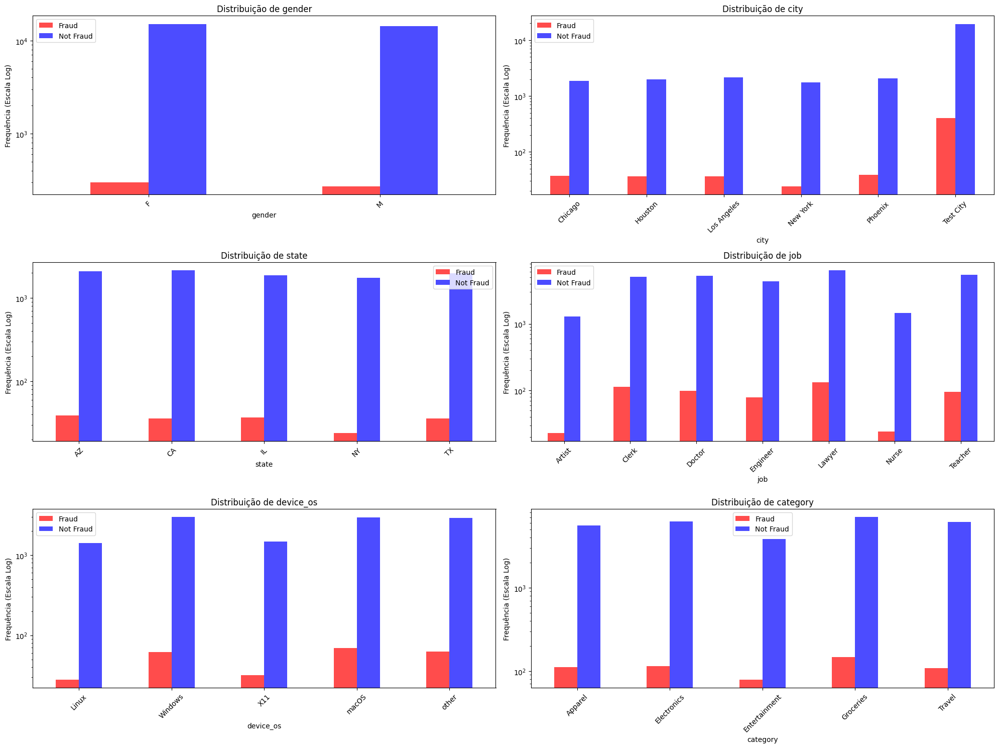

In [22]:
plt.figure(figsize=(20, 15))

is_fraud = data[data['is_fraud'] == 1][['gender', 'city', 'state', 'job', 'device_os', 'category']]
is_not_fraud = data[data['is_fraud'] == 0][['gender', 'city', 'state', 'job', 'device_os', 'category']]

# Iterar sobre as colunas categóricas e criar gráficos
for i, col in enumerate(is_fraud.columns):
    plt.subplot(3, 2, i + 1)
    
    fraud_counts = is_fraud[col].value_counts()
    not_fraud_counts = is_not_fraud[col].value_counts()
    
    combined = pd.DataFrame({
        'Fraud': fraud_counts,
        'Not Fraud': not_fraud_counts
    }).fillna(0)
    
    combined.plot(kind='bar', ax=plt.gca(), color=['red', 'blue'], alpha=0.7)
    plt.title(f"Distribuição de {col}")
    plt.xlabel(col)
    plt.ylabel("Frequência (Escala Log)")
    plt.yscale('log')  # Escala logarítmica
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

Ambos os **géneros** possuem uma proporção semelhante de fraudes em relação a transações legítimas, o mesmo com a variável **state**.

Como já visto, a cidade **Test City** tem uma proporção mais alta de fraude em relação às outras.

Certas profissões, como **Lawyer** e **Clerk**, têm volumes maiores de transações legítimas e fraudulentas. O mesmo quando temos em conta os sitemas operativos **macOs** e **windows**.

A variável **category** pode ser um bom indicador, especialmente em categorias específicas, como **Groceries** e **Electronics**, que podem ser mais suscetíveis a fraudes.

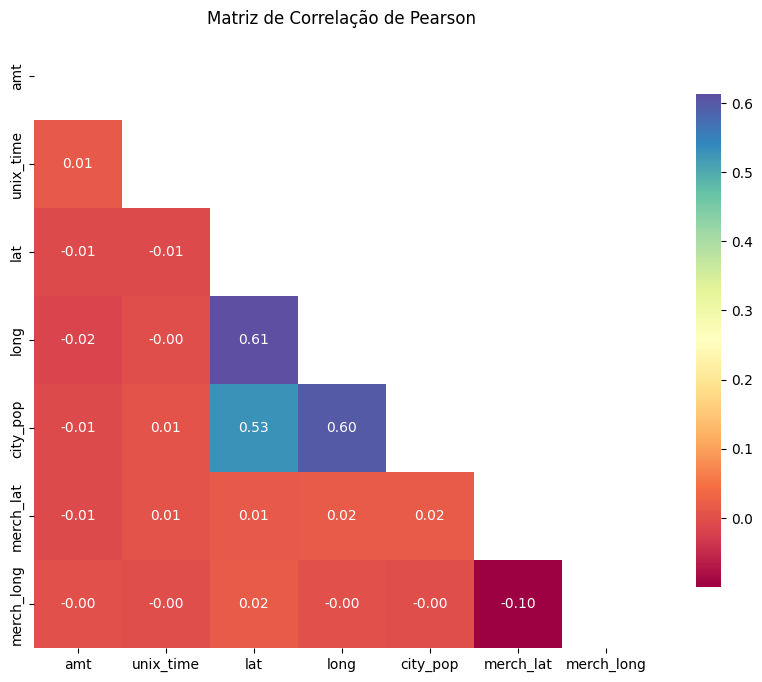

In [23]:
numeric_data = data.select_dtypes(include=['float64', 'int64'])

# Criar a matriz de correlação de Pearson
correlation_matrix = numeric_data.corr()

# Retirar a parte superior da matriz
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

plt.figure(figsize=(12, 8))
sb.heatmap(correlation_matrix, mask=mask, annot=True, fmt=".2f", cmap="Spectral", square=True, cbar_kws={"shrink": .8})

plt.title("Matriz de Correlação de Pearson")
plt.show()

Todas as variáveis numéricas apresentam **correlação muito baixa**, exceto a **city_pop** com a **lat** e a **long**, além da relação entre **lat** e **long**, que mostram correlações moderadas. Isto sugere que algumas variáveis não apresentam uma relação linear direta forte, o que pode indicar que a fraude pode ser influenciadas por combinações mais complexas, em vez de relações isoladas ou lineares. Esta conclusão já tinha sido retirada para alguns atributos nos textos anteriores.

O mesmo se pode observar no gráfico abaixo da correlação de **Spearman**. Nenhuma das variáveis parece ter uma correlação monótona minimamente significativa tirando os casos já referidos acima.

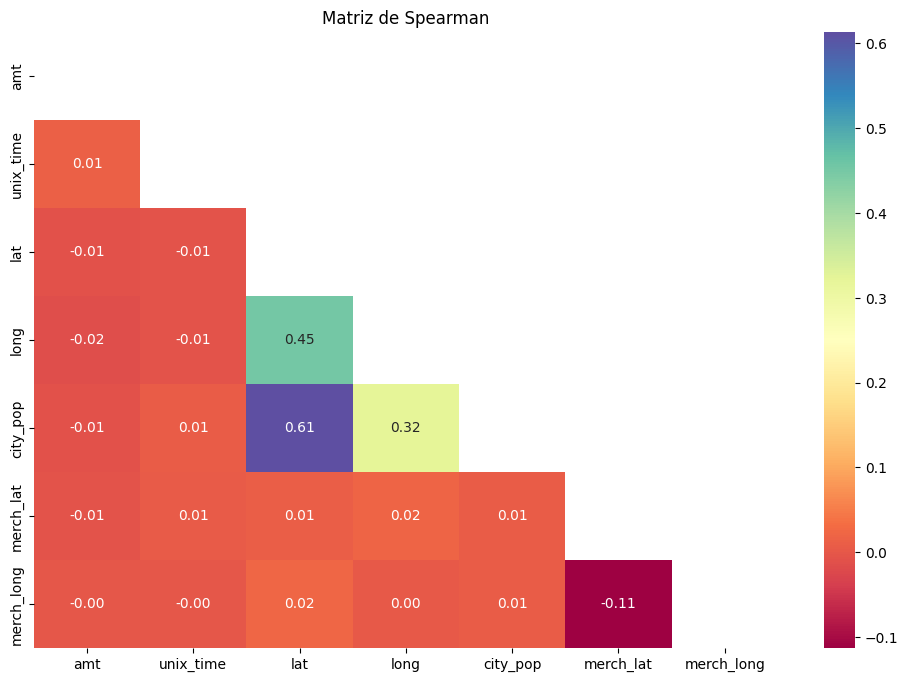

In [24]:
numeric_data = data.select_dtypes(include=['float64', 'int64'])

# Calcular a matriz de Spearman
spearman_corr_matrix = numeric_data.corr(method='spearman')
mask = np.triu(np.ones_like(spearman_corr_matrix, dtype=bool))

# Criar o heatmap
plt.figure(figsize=(12, 8))
sb.heatmap(spearman_corr_matrix, mask=mask, annot=True, cmap='Spectral', fmt=".2f", cbar=True)
plt.title('Matriz de Spearman')
plt.show()

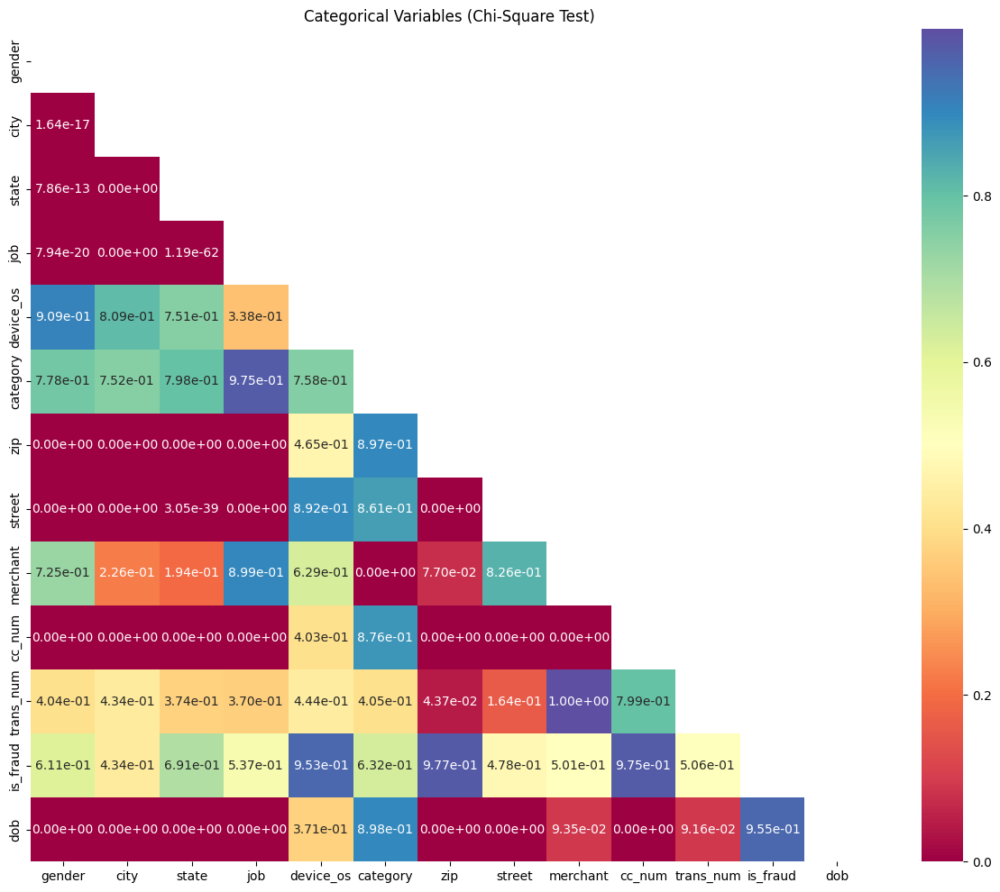

In [25]:
categorical_vars = ['gender', 'city', 'state', 'job', 'device_os', 'category', 'zip', 'street', 'merchant', 'cc_num', 'trans_num', 'is_fraud', 'dob']
df_categorical = data[categorical_vars]

# Criar a matriz para guardar os p-valores
p_values_matrix = pd.DataFrame(index=categorical_vars, columns=categorical_vars)

# Calcular o qui-quadrado para cada par de variáveis
for var1 in categorical_vars:
    for var2 in categorical_vars:
        if var1 == var2:
            p_values_matrix.loc[var1, var2] = np.nan  # Ignorar a diagonal principal
        else:
            contingency_table = pd.crosstab(df_categorical[var1], df_categorical[var2])
            try:
                _, p_value, _, _ = chi2_contingency(contingency_table)
                p_values_matrix.loc[var1, var2] = p_value
            except ValueError:
                p_values_matrix.loc[var1, var2] = np.nan

p_values_matrix = p_values_matrix.astype(float)

# Retirar a parte superior da matriz
mask = np.tril(np.ones(p_values_matrix.shape), k=-1) 
p_values_matrix_masked = p_values_matrix.where(mask == 1)

# Criar heatmap
plt.figure(figsize=(15, 12))
sb.heatmap(p_values_matrix_masked, annot=True, fmt=".2e", cmap="Spectral", cbar=True)
plt.title("Categorical Variables (Chi-Square Test)")
plt.show()

Como a matriz de correlação das variáveis numéricas não apresenta correlações fortes, foi necessário analisar as variáveis categóricas para perceber se existe alguma relação importante.

A matriz apresenta *p-valores* para cada par de variáveis, indicando a probabilidade das variáveis serem independentes entre elas - hipótese *H0*. *p-valores* baixos sugerem que existe uma relação estatisticamente significativa entre as variáveis, enquanto p-valores altos indicam que não há evidências suficientes para rejeitar a hipótese *H0*. A coloração da matriz ilustra essas relações, com tons de vermelho indicado relações fortes de dependência e portanto rejeição da hipótese *H0* e os outros tons representam mais independência, logo não rejeitamos *H0*.

Relações fortes (p-valores muito baixos), como esperado, dada a correlação geográfica entre **street**, **state**, **city** e **zip**. Esses padrões podem ajudar a identificar locais de alto risco para fraudes. O **job** também apresenta *p-valores* baixos com varíaveis que representam a localização como **city**, **street** e **zip**. 

A categoria e o *id* do comerciante támbem parece estarem relacionados. 

Também se pode concluir que o **cc_num** está bastante relacionado com a **localização**, o **gender** e o **job** do utilizador.

Vamos verificar agora a qualidade dos dados antes de fazer a preparação dos mesmos. Pertende-se identificar erros e inconsistências nos dados, como valores ausentes, duplicados, entre outros.

In [26]:
data.isnull().sum()

index                        0
trans_date_trans_time      100
cc_num                       0
device_os                17964
merchant                     0
amt                        100
trans_num                    0
unix_time                    0
is_fraud                     0
first                       10
last                        10
gender                      10
street                      10
city                        10
zip                        216
job                        216
dob                         10
lat                      19980
long                     19980
city_pop                 19980
state                    19980
category                   599
merch_lat                  599
merch_long                  10
merchant_id                 10
dtype: int64

Focando apenas nas variável mais relevantes, conseguimos verificar que existem alguns valores em falta em **amt**, **device_os**, **gender**, **city**, **job**, **dob** e **category**, entre outros. Esses serão imputados na próxima fase.

Podemos também verificar que, para atributos que representam essencialmente a mesma informação, há inconsistências nos valores ausentes. Por exemplo, no caso dos atributos **merchant** e **merchant_id**, observamos que existem valores ausentes em **merchant_id**, mas não em **merchant**. Portanto, optamos por manter o atributo **merchant**, que possui informações mais completas. Da mesma forma, para os atributos **trans_date_trans_time** e **unix_time**, verificamos que **unix_time** não apresenta valores ausentes, enquanto **trans_date_trans_time** possui. Assim, escolhemos o atributo **unix_time**. Na próxima fase trataremos de remover os que não são relevantes.

Identificamos que os atributos **lat** e **long** possuem uma quantidade significativa de valores ausentes. Além disso, a ampla distribuição desses valores torna inviável preenchê-los de forma consistente e coerente, sem introduzir vieses ou comprometer a qualidade dos dados. Por este motivo, decidimos remover esses atributos da análise. Da mesma forma, ao avaliar os atributos **merch_lat** e **merch_long**, verificamos que **merch_lat** apresenta ainda mais valores ausentes do que **merch_long**. Considerando essa inconsistência e a dificuldade de completar essas informações de maneira confiável, optamos por remover ambos os atributos relacionados com a localização do comerciante. A mesma justificação se aplica ao atributo **zip** e **street**. 

In [27]:
data.nunique()

index                    29970
trans_date_trans_time    29868
cc_num                    1101
device_os                    5
merchant                   101
amt                      22615
trans_num                29470
unix_time                29959
is_fraud                     2
first                      108
last                       108
gender                       2
street                     102
city                         6
zip                       1077
job                          7
dob                       1062
lat                          5
long                         5
city_pop                     5
state                        5
category                     5
merch_lat                   98
merch_long                 100
merchant_id                100
dtype: int64

In [28]:
na_rows = data[data.isna().any(axis=1)]

# Listar as cidades com valores ausentes
na_city_pop = data[data["city_pop"].isna()]["city"].unique()
na_state = data[data["state"].isna()]["city"].unique()

print("Cidades com valores de city_pop ausentes:", na_city_pop)
print("Estados com valores de state ausentes:", na_state)

Cidades com valores de city_pop ausentes: [nan 'Test City']
Estados com valores de state ausentes: [nan 'Test City']


Os atributos **state** e **city_pop** apresentam valores ausentes apenas para uma cidade específica, **Test City**. Devido ao número limitado de cidades no conjunto de dados, calcular a moda e a média, respetivamente, com base neste contexto restrito não seria uma abordagem confiável. Além disso, a baixa representatividade de cidades torna inviável imputar valores que reflitam com precisão a realidade da **Test City**, justificando a remoção desses atributos da análise.

In [29]:
print(data.duplicated(subset='trans_num').sum())

530


In [30]:
data['is_fraud'].unique()

array([0, 1], dtype=object)

In [31]:
data['gender'].unique()

array(['F', 'M', nan], dtype=object)

In [32]:
data['category'].unique()

array([nan, 'Entertainment', 'Electronics', 'Groceries', 'Apparel',
       'Travel'], dtype=object)

In [33]:
data['job'].unique()

array([nan, 'Nurse', 'Doctor', 'Teacher', 'Engineer', 'Clerk', 'Artist',
       'Lawyer'], dtype=object)

In [34]:
data['device_os'].unique()

array([nan, 'macOS', 'X11', 'other', 'Windows', 'Linux'], dtype=object)

In [35]:
data['city'].unique()

array(['Chicago', 'New York', 'Phoenix', 'Los Angeles', 'Houston', nan,
       'Test City'], dtype=object)

Os valores do atributo **trans_num** deveriam ser todos únicos mas existem **530** repetidos. Os duplicados devem ser, portanto, removidos. 

Ficamos, também, com informação que os valores dos atributos categóricos descritos acima são todos plausíveis, não tendo erros de codificação ou valores inválidos.

O atributo booleano assume só valores de **0** ou **1**, o que é o esperado.

## Preparação dos Dados

Primeiramente, vamos remover os atributos que não são relevantes para o modelo, como já foi visto acima, e que não vamos utilizar para fazer **feature engineering**.

In [36]:
data = data.drop(columns= ['index', 'first', 'last', 'lat', 'long', 'merch_lat', 'merch_long', 'merchant_id', 'trans_date_trans_time', 'street', 'zip', 'state', 'city_pop'])
data.head()

,cc_num,device_os,merchant,amt,trans_num,unix_time,is_fraud,gender,city,job,dob,category
0,2801374844713453,NaN,Merchant_85,252.75,TRANS_662964,1672533543,0,F,Chicago,NaN,2002-10-12,NaN
1,3460245159749480,NaN,Merchant_23,340.17,TRANS_134939,1672535768,0,M,New York,Nurse,2001-12-23,Entertainment
2,7308701990157768,macOS,Merchant_70,76.38,TRANS_258923,1672536268,0,M,Phoenix,Doctor,1978-12-13,Electronics
3,8454886440761098,X11,Merchant_33,368.88,TRANS_226814,1672538817,0,F,Phoenix,Teacher,1965-04-21,Electronics
4,6350332939133843,NaN,Merchant_90,323.32,TRANS_668449,1672539054,0,F,New York,Nurse,1997-05-17,Groceries


Em vez de manter a data de nascimento **dob**, optamos por categorizar os dados em faixas etárias, pois esta abordagem facilita a análise e a identificação de padrões relacionados à idade (como foi visto nas estatísticas retiradas na etapa anterior). As faixas etárias são mais práticas e intuitivas para interpretar tendências e por isso, as categorias de idade foram integradas no novo atributo age_category.

In [37]:
data['dob'] = pd.to_datetime(data['dob'])

# Calcular as faixas etárias
def categorize_age(dob):
    today = datetime.today()
    age = today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
    if 17 <= age <= 36:
        return 'Young Adult'
    elif 37 <= age <= 55:
        return 'Adult'
    elif 56 <= age <= 74:
        return 'Middle Age'
    else:
        return 'Senior'

data['age_category'] = data['dob'].apply(categorize_age)
data.drop(columns=['dob'], inplace=True)

A criação da coluna **transactions_count** permite identificar o número de transações que ocorreram entre o cliente e o comerciante até a data de uma transação específica. Estes dados parecem ser relevantes para entender o histórico das interações, ajudando a analisar padrões e a detetar comportamentos atípicos relativamente ao volume de transações ao longo do tempo. Assim, oferece uma visão mais detalhada do relacionamento entre o **cliente** e o **comerciante**.

In [38]:
data = data.sort_values(by=['unix_time'])

# Criar a coluna 'transactions_count'
data['transactions_count'] = (
    data.groupby(['cc_num', 'merchant'])['unix_time']
      .cumcount() 
)

data['transactions_count'] = data['transactions_count'] + 1  # Começar a contagem em 1

A criação da coluna **unique_merchants_count** permite acompanhar o número crescente de comerciantes distintos com os quais o cliente realizou transações até a data de uma transação específica. Esta métrica é bastante útil para entender a diversidade de interações do cliente com os diferentes comerciantes ao longo do tempo.

In [39]:
unique_merchants = set()
unique_merchants_count = []

for merchant in data['merchant']:
    unique_merchants.add(merchant) 
    unique_merchants_count.append(len(unique_merchants))  # Contar os únicos até ao momento

data['unique_merchants_count'] = unique_merchants_count

data = data.drop(columns=['merchant'])

Foram adicionadas várias transformações à variável **unix_time**. A coluna **time_since_last** foi criada para medir o tempo, em segundos, desde a última transação de um cliente, fornecendo informações úteis sobre a frequência das transações. A variável **period_of_day** classifica as transações em períodos do dia (Madrugada, Manhã, Tarde e Noite), enquanto **day_of_week** identifica o dia da semana em que cada transação ocorreu.

Para permitir que o modelo perceba a natureza das variáveis, os períodos do dia e os dias da semana foram convertidos em representações cíclicas (sin e cos).

In [40]:
data['datetime'] = pd.to_datetime(data['unix_time'], unit='s')

# Calcular o tempo desde a última transação
data.sort_values(by=['cc_num', 'datetime'], inplace=True)
data['time_since_last'] = data.groupby('cc_num')['datetime'].diff().dt.total_seconds()
data['time_since_last'] = data['time_since_last'].fillna(0)

data['hour'] = data['datetime'].dt.hour

# definir os períodos do dia 
def categorize_period(hour):
    if 0 <= hour < 8:
        return 'Madrugada'
    elif 8 <= hour < 13:
        return 'Manhã'
    elif 13 <= hour < 18:
        return 'Tarde'
    else:
        return 'Noite'

data['period_of_day'] = data['hour'].apply(categorize_period)

# Adicionar o dia da semana
data['day_of_week'] = data['datetime'].dt.day_name()

# Transformar o dia da semana em variáveis cíclicas
day_mapping = {'Sunday': 0, 'Monday': 1, 'Tuesday': 2, 'Wednesday': 3,
               'Thursday': 4, 'Friday': 5, 'Saturday': 6}
data['day_of_week_num'] = data['day_of_week'].map(day_mapping)
data['day_of_week_sin'] = np.sin(2 * np.pi * data['day_of_week_num'] / 7)
data['day_of_week_cos'] = np.cos(2 * np.pi * data['day_of_week_num'] / 7)

# Transformar o período do dia em variáveis cíclicas
period_mapping = {'Madrugada': 0, 'Manhã': 1, 'Tarde': 2, 'Noite': 3}
data['period_of_day_num'] = data['period_of_day'].map(period_mapping)
data['period_of_day_sin'] = np.sin(2 * np.pi * data['period_of_day_num'] / 4)
data['period_of_day_cos'] = np.cos(2 * np.pi * data['period_of_day_num'] / 4)

data = data.drop(columns=['hour', 'day_of_week', 'day_of_week_num', 
                          'period_of_day', 'period_of_day_num', 'datetime', 'unix_time', 'cc_num'])

O algoritmo realiza o teste de **Shapiro-Wilk** para avaliar se as variáveis seguem uma distribuição normal. Este teste deve ser feito para determinar qual é a abordagem mais adequada para os dados, garantindo que os atributos estejam na mesma escala e, consequentemente, melhorem o desempenho do modelo.

Se os resultados do teste indicarem que uma variável segue uma distribuição normal (p-valor > 0.05), utilizamos o **StandardScaler**, que padroniza os dados com **média igula a 0** e **desvio padrão igual a 1**, preservando a natureza da distribuição normal. Por outro lado, se os resultados indicarem que a distribuição não é normal (p-valor ≤ 0.05), usamos o **MinMaxScaler**, que normaliza os dados num intervalo fixo **entre 0 e 1**.

Os resultados do teste mostraram que nenhuma das variáveis avaliadas segue uma distribuição normal. Por isso, optamos por usar o **MinMaxScaler** para garantir uma normalização adequada.

In [41]:
columns_to_test = ['amt', 'transactions_count', 'unique_merchants_count', 'time_since_last', 'day_of_week_sin', 'day_of_week_cos', 'period_of_day_sin', 'period_of_day_cos']

# Realizar o teste Shapiro-Wilk 
for column in columns_to_test:
    if column in data.columns:
        non_na_data = data[column].dropna()
        stat, p = shapiro(non_na_data)
        print(f'\nShapiro-Wilk Test for {column}:')
        print(f'Stat=%.3f, p=%.3f' % (stat, p))
        if p > 0.05:
            print("Provavelmente normal")
        else:
            print("Provavelmente não normal")


Shapiro-Wilk Test for amt:
Stat=0.955, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for transactions_count:
Stat=0.690, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for unique_merchants_count:
Stat=0.059, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for time_since_last:
Stat=0.521, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for day_of_week_sin:
Stat=0.882, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for day_of_week_cos:
Stat=0.839, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for period_of_day_sin:
Stat=0.801, p=0.000
Provavelmente não normal

Shapiro-Wilk Test for period_of_day_cos:
Stat=0.804, p=0.000
Provavelmente não normal


Nesta etapa, os dados foram divididos em **inputs** (variáveis preditivas) e **labels** (variável-alvo, **is_fraud**).

A seguir, utilizamos a função **train_test_split** para dividir os dados em dois conjuntos: treino (75% dos dados) e teste (25% dos dados). A divisão foi realizada de forma estratificada, garantindo que a proporção de classes da variável **is_fraud** seja mantida em ambos os conjuntos. Além disso, os dados foram baralhados **shuffle=True** para evitar que a ordem original influencie o treino do modelo.

Após a divisão, identificamos as colunas numéricas no conjunto de dados para aplicar o MinMaxScaler.

In [42]:
all_inputs = data.drop(['is_fraud'], axis = 1)

all_labels = data['is_fraud'] 
(training_inputs, testing_inputs, training_classes, testing_classes) = train_test_split(all_inputs, all_labels, test_size = 0.25, random_state = 42, stratify=all_labels, shuffle=True)

numeric_columns = training_inputs.select_dtypes(include=['float64' , 'int64']).columns

training_inputs.to_csv('CreditCardTransactions/unscaled_data.csv', index=False)

scaler = MinMaxScaler()
training_inputs[numeric_columns] = scaler.fit_transform(training_inputs[numeric_columns])
testing_inputs[numeric_columns] = scaler.transform(testing_inputs[numeric_columns])

Focando no atributo **trans_num**, a análise identificou **530** valores duplicados. Alguns correspondiam a linhas idênticas, permitindo a remoção de qualquer uma. No entanto, em casos onde as linhas apresentavam diferenças, como a presença de valores **NA**, priorizou-se a remoção das linhas com maior número de **NA**.

In [43]:
# Adicionar um índice 
training_inputs = training_inputs.reset_index()
training_classes = training_classes.reset_index()

# Identificar a melhor linha 
training_inputs['num_na'] = training_inputs.isna().sum(axis=1)
df_unico = training_inputs.loc[training_inputs.groupby('trans_num')['num_na'].idxmin()].reset_index(drop=True)
print(df_unico.duplicated(subset='trans_num').sum())

valid_indices = df_unico['index']

training_inputs = df_unico.drop(columns=['num_na', 'trans_num', 'index'])
training_classes = training_classes[training_classes['index'].isin(valid_indices)].reset_index(drop=True)
training_classes = training_classes.drop(columns=['index'])
testing_inputs = testing_inputs.drop(columns=['trans_num'])

print(f"Número de linhas em training_inputs: {len(training_inputs)}")
print(f"Número de linhas em training_classes: {len(training_classes)}")


0
Número de linhas em training_inputs: 22208
Número de linhas em training_classes: 22208


Os dados de treino foram guardados para imputarmos os valores em falta utilizando o algoritmo **k-Nearest Neighbors (kNN)** em **R**. Este método preenche os valores ausentes ao analisar os pontos mais próximos, garantindo que os valores em falta sejam preenchidas de maneira consistente e que mantenham a integridade e a coerência das relações entre os dados.

O código usado em **R** está abaixo representado:
    
```R
library(VIM)

setwd("C:/Users/Matilde/Documents/GitHub/Credit-Card-Fraud-Detection/CreditCardTransactions")
data <- read.csv("unimputed_data.csv", na.strings = c("NA", "?", ""))

data_imputed <- kNN(data, k = 5)

# Remover as colunas auxiliares criadas pelo kNN
data_imputed <- data_imputed[, !grepl("_imp", names(data_imputed))]

write.csv(data_imputed, "imputed_data.csv", row.names = FALSE, quote = FALSE)
'''

In [44]:
unimputed_data = training_inputs.copy()

unimputed_data.to_csv('CreditCardTransactions/unimputed_data.csv', index=False)

In [45]:
training_inputs = pd.read_csv('CreditCardTransactions/imputed_data.csv')
training_inputs.head(5)

,device_os,amt,gender,city,job,category,age_category,transactions_count,unique_merchants_count,time_since_last,day_of_week_sin,day_of_week_cos,period_of_day_sin,period_of_day_cos
0,macOS,0.611685,M,Houston,Nurse,Groceries,Young Adult,0.0,1.0,0.027356,0.722521,5.551115e-17,0.5,1.0
1,Windows,0.281912,M,Los Angeles,Artist,Groceries,Middle Age,0.0,1.0,0.174292,0.000000,3.568959e-01,0.5,1.0
2,macOS,0.732839,F,Phoenix,Nurse,Apparel,Middle Age,0.0,1.0,0.233138,0.000000,3.568959e-01,0.5,0.0
3,macOS,0.742239,M,Phoenix,Lawyer,Groceries,Young Adult,0.0,1.0,0.096178,0.722521,5.551115e-17,0.0,0.5
4,macOS,0.409039,M,Test City,Lawyer,Groceries,Middle Age,0.0,1.0,0.000127,1.000000,3.568959e-01,0.5,0.0


Tendo os valores ausentes imputados no conjunto de treino, vamos também tratar dos valores em falta no conjunto de teste. Para isso, calculamos a média das variáveis numéricas e a moda das variáveis categóricas com base nos dados de treino.

Esses valores calculados foram então utilizados para preencher os dados em falta no conjunto de teste, assegurando que o tratamento das ausências não introduza viés ou inconsistências entre os conjuntos.

In [46]:
numerical_cols = training_inputs.select_dtypes(include=['number']).columns
categorical_cols = training_inputs.select_dtypes(include=['object', 'category']).columns

# Calcular a média e a moda a partir do conjunto de treino
mean_values = training_inputs[numerical_cols].mean()
mode_values = training_inputs[categorical_cols].mode().iloc[0]

# Imputar os valores em falta no conjunto de teste
testing_inputs[numerical_cols] = testing_inputs[numerical_cols].fillna(mean_values)
testing_inputs[categorical_cols] = testing_inputs[categorical_cols].fillna(mode_values)

print(testing_inputs.isnull().sum())

device_os                 0
amt                       0
gender                    0
city                      0
job                       0
category                  0
age_category              0
transactions_count        0
unique_merchants_count    0
time_since_last           0
day_of_week_sin           0
day_of_week_cos           0
period_of_day_sin         0
period_of_day_cos         0
dtype: int64


Como havia uma cidade (**Test City**) sem as suas informações completas, o que levou à exclusão de várias variáveis relacionadas, decidimos incluir essa lacuna como uma nova variável no modelo. Foi criada a variável **city_has_info**, que identifica se uma cidade possui informações completas ou não. Cidades com dados disponíveis têm **1**, caso contrário têm **0**.

In [47]:
training_inputs['city_has_info'] = training_inputs['city'].apply(lambda x: 0 if x == 'Test City' else 1)
testing_inputs['city_has_info'] = testing_inputs['city'].apply(lambda x: 0 if x == 'Test City' else 1)

training_inputs.head(5)

,device_os,amt,gender,city,job,category,age_category,transactions_count,unique_merchants_count,time_since_last,day_of_week_sin,day_of_week_cos,period_of_day_sin,period_of_day_cos,city_has_info
0,macOS,0.611685,M,Houston,Nurse,Groceries,Young Adult,0.0,1.0,0.027356,0.722521,5.551115e-17,0.5,1.0,1
1,Windows,0.281912,M,Los Angeles,Artist,Groceries,Middle Age,0.0,1.0,0.174292,0.000000,3.568959e-01,0.5,1.0,1
2,macOS,0.732839,F,Phoenix,Nurse,Apparel,Middle Age,0.0,1.0,0.233138,0.000000,3.568959e-01,0.5,0.0,1
3,macOS,0.742239,M,Phoenix,Lawyer,Groceries,Young Adult,0.0,1.0,0.096178,0.722521,5.551115e-17,0.0,0.5,1
4,macOS,0.409039,M,Test City,Lawyer,Groceries,Middle Age,0.0,1.0,0.000127,1.000000,3.568959e-01,0.5,0.0,0


No último passo de preparação, as variáveis categóricas foram convertidas em formato numérico utilizando one-hot encoding, criando colunas binárias para representar cada categoria. Para a variável **gender**, foi aplicada a codificação com exclusão da primeira categoria para evitar redundâncias. O resto das variáveis categóricas foram transformadas sem exclusão de categorias, preservando toda a informação.

In [48]:
categorical_columns1 = ['gender']
training_inputs = pd.get_dummies(training_inputs, columns=categorical_columns1, drop_first=True, dtype=int)
testing_inputs = pd.get_dummies(testing_inputs, columns=categorical_columns1, drop_first=True, dtype=int)

categorical_columns2 = ['device_os', 'category', 'age_category', 'job', 'city']
training_inputs = pd.get_dummies(training_inputs, columns=categorical_columns2, drop_first=False, dtype=int)
testing_inputs = pd.get_dummies(testing_inputs, columns=categorical_columns2, drop_first=False, dtype=int)

training_inputs.head(5)

,amt,transactions_count,unique_merchants_count,time_since_last,day_of_week_sin,day_of_week_cos,period_of_day_sin,period_of_day_cos,city_has_info,gender_M,...,job_Engineer,job_Lawyer,job_Nurse,job_Teacher,city_Chicago,city_Houston,city_Los Angeles,city_New York,city_Phoenix,city_Test City
0,0.611685,0.0,1.0,0.027356,0.722521,5.551115e-17,0.5,1.0,1,1,...,0,0,1,0,0,1,0,0,0,0
1,0.281912,0.0,1.0,0.174292,0.000000,3.568959e-01,0.5,1.0,1,1,...,0,0,0,0,0,0,1,0,0,0
2,0.732839,0.0,1.0,0.233138,0.000000,3.568959e-01,0.5,0.0,1,0,...,0,0,1,0,0,0,0,0,1,0
3,0.742239,0.0,1.0,0.096178,0.722521,5.551115e-17,0.0,0.5,1,1,...,0,1,0,0,0,0,0,0,1,0
4,0.409039,0.0,1.0,0.000127,1.000000,3.568959e-01,0.5,0.0,0,1,...,0,1,0,0,0,0,0,0,0,1


Terminadas as etapas de análise e preparação dos dados, vamos agora guardar o *dataset* limpo e preparado para as próximas etapas.

In [49]:
training_inputs.to_csv('CreditCardTransactions/training_dataset.csv', index=False)
testing_inputs.to_csv('CreditCardTransactions/testing_dataset.csv', index=False)
training_classes.to_csv('CreditCardTransactions/training_classes.csv', index=False)
testing_classes.to_csv('CreditCardTransactions/testing_classes.csv', index=False)

Foi realizado **clustering** utilizando as variáveis geradas durante a etapa de **feature engineering**, com o objetivo de identificar padrões nos dados. As variáveis selecionadas representam características importantes que descrevem uma transação, como valores monetários, frequência de transações, relação com comerciantes, comportamento temporal (tempo desde a última transação e períodos do dia), e a localização (cidade).

Antes de correr o algoritmo **k-means**, foi necessário correr métodos que dissessem qual é o número mais adequado de **clusters**. Foram, assim avaliados diferentes números de clusters utilizando o método **Elbow** e **Silhouette**. Com base na análise dos gráficos, optou-se por utilizar **10 clusters**, apesar que pelo **Elbow** **8** também parece uma boa opção.

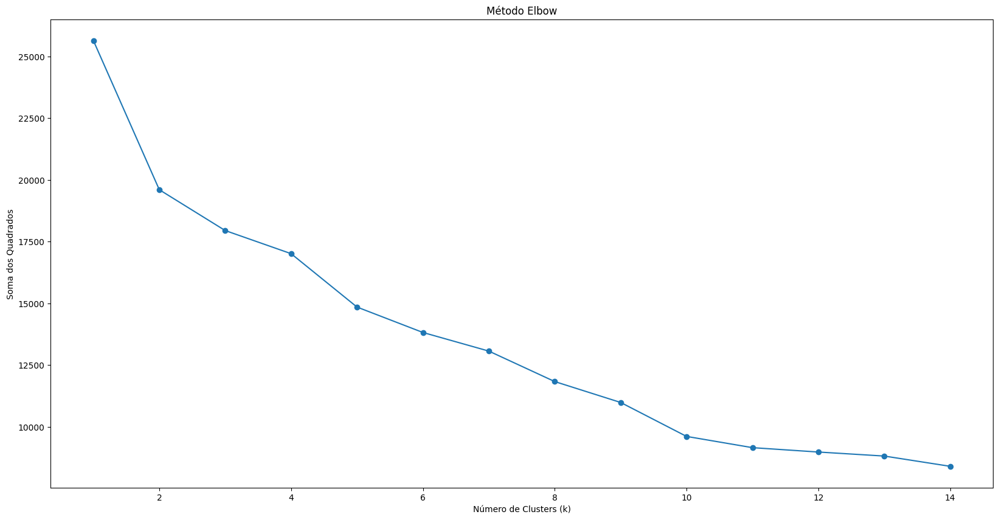

In [50]:
selected_columns = ['amt', 'time_since_last', 'transactions_count', 'unique_merchants_count', 'day_of_week_sin', 'day_of_week_cos', 'period_of_day_sin', 'period_of_day_cos', 'city_Chicago', 'city_Houston', 'city_Los Angeles', 'city_New York', 'city_Phoenix', 'city_Test City']
data_for_clustering = training_inputs[selected_columns]

inertia = []
k_values = range(1, 15)

# Elbow Method
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_for_clustering)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(20, 10))
plt.plot(k_values, inertia, marker='o')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Soma dos Quadrados')
plt.title('Método Elbow')
plt.show()

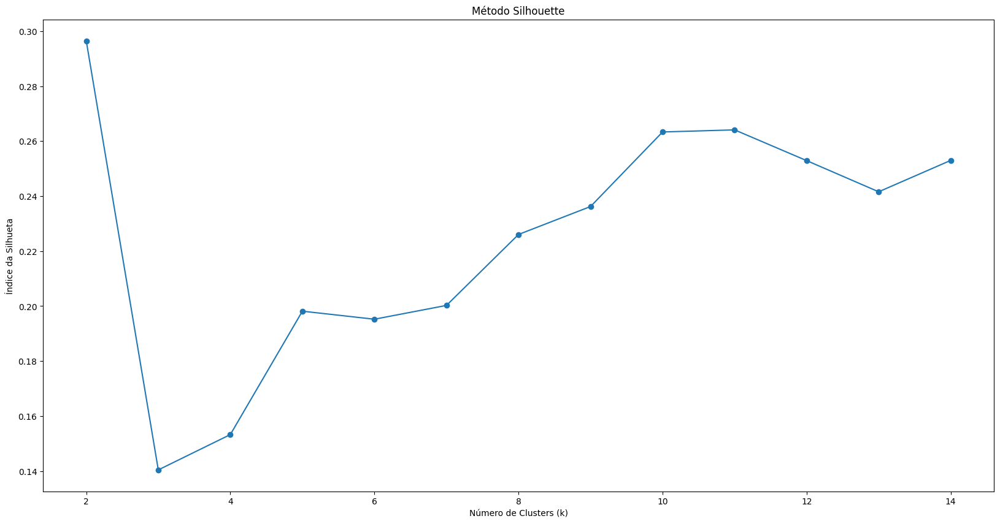

In [51]:
silhouette_scores = []

# Silhouette Score
for k in range(2, 15): 
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_for_clustering)
    score = silhouette_score(data_for_clustering, kmeans.labels_)
    silhouette_scores.append(score)

plt.figure(figsize=(20, 10))
plt.plot(range(2, 15), silhouette_scores, marker='o')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Índice da Silhueta')
plt.title('Método Silhouette')
plt.show()

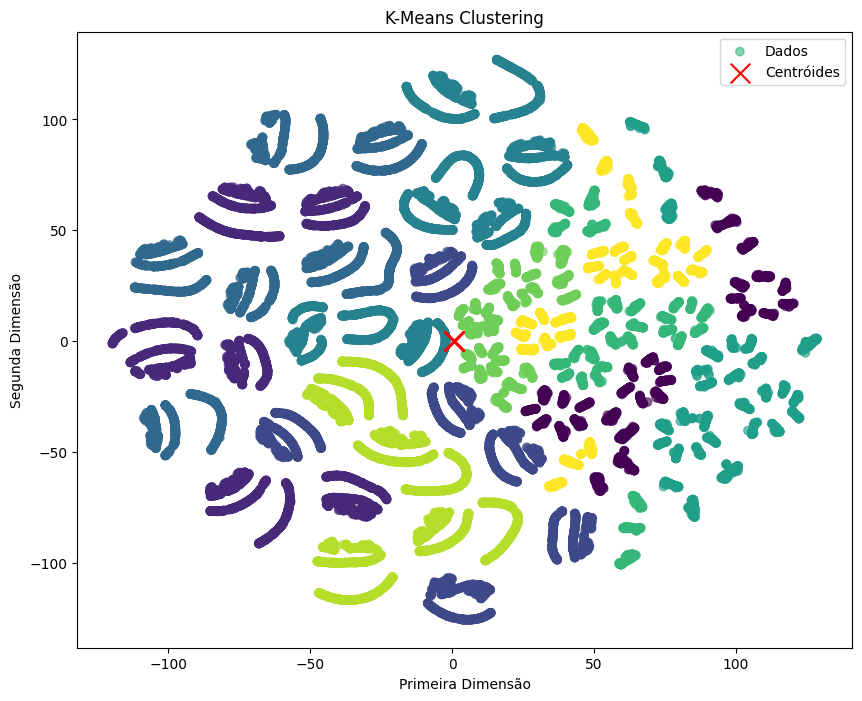

In [52]:
data_np = data_for_clustering.to_numpy()

kmeans = KMeans(n_clusters=10, random_state=42)
kmeans.fit(data_np)

# Obter rótulos e centróides
labels = kmeans.labels_
centroids = kmeans.cluster_centers_

tsne = TSNE(n_components=2, random_state=42)
data_tsne = tsne.fit_transform(data_np)

# Visualizar os resultados
plt.figure(figsize=(10, 8))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], c=labels, cmap='viridis', alpha=0.6, label="Dados")
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', marker='x', s=200, label="Centróides")
plt.title("K-Means Clustering")
plt.xlabel("Primeira Dimensão")
plt.ylabel("Segunda Dimensão")
plt.legend()
plt.show()

O gráfico apresentado reflete o resultado do **k-means clustering**, onde cada cor representa um cluster identificado pelo algoritmo. Estes clusters mostram que os dados foram separados em grupos distintos com base nas variáveis fornecidas, indicando a existência de padrões diferenciados nas características das transações. A distribuição dos clusters revela variações na densidade. Alguns clusters são mais compactos, representando transações com padrões mais homogéneos, enquanto outros são mais dispersos, indicando maior diversidade nos dados.

Também foi utilizado o algoritmo **DBSCAN** para realizar o **clustering** com as mesmas variáveis utilizadas no **K-Means**. Foram testados diferentes valores para **eps** (distância máxima entre pontos para serem considerados vizinhos) e **min_samples** (número mínimo de pontos para formar um cluster). O objetivo foi identificar a combinação de parâmetros que resultasse no melhor **silhouette score**, avaliando a qualidade dos grupos formados. 

Esse processo permitiu explorar a capacidade do **DBSCAN** de identificar clusters e de lidar com **outliers**, complementando a análise realizada com o **K-Means**.

In [53]:
eps_values = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
min_samples_values = [3, 4, 5, 6, 7, 8, 9, 10]

best_eps = None
best_min_samples = None
best_score = -1

for eps in eps_values:
    for min_samples in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(data_np)
        
        if len(set(labels)) > 1:
            score = silhouette_score(data_np, labels)
            if score > best_score:
                best_score = score
                best_eps = eps
                best_min_samples = min_samples

print(f"Melhor eps: {best_eps}, Melhor min_samples: {best_min_samples}, Melhor Score: {best_score:.4f}")

Melhor eps: 0.4, Melhor min_samples: 3, Melhor Score: 0.3720


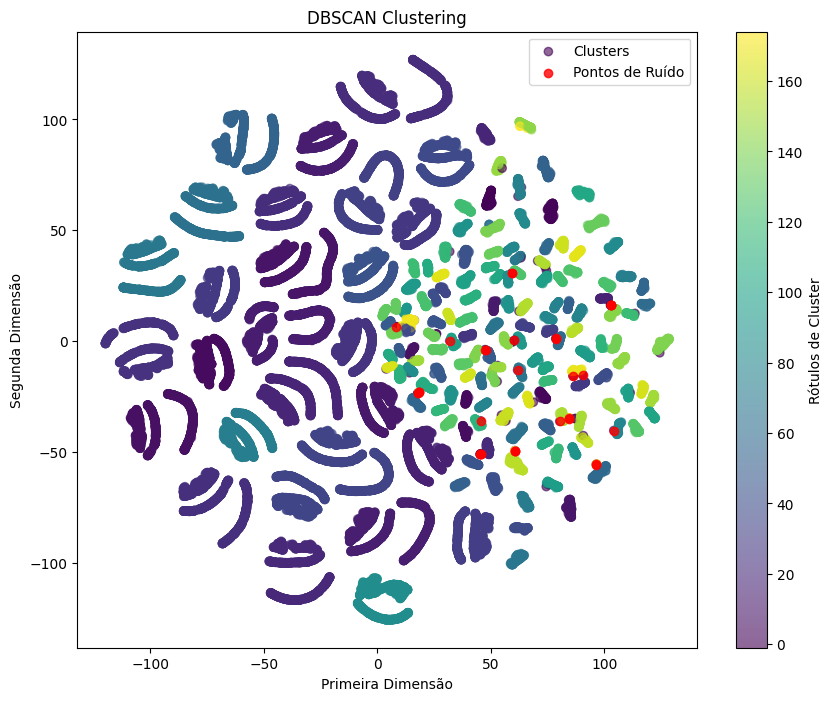

In [54]:
# DBSCAN
noise_points = labels == -1
dbscan = DBSCAN(eps=0.4, min_samples=3)
dbscan.fit(data_np)
labels = dbscan.labels_

tsne = TSNE(n_components=2, random_state=42)
data_tsne = tsne.fit_transform(data_np)

# Visualizar os resultados
plt.figure(figsize=(10, 8))
scatter = plt.scatter(data_tsne[:, 0], data_tsne[:, 1], c=labels, cmap='viridis', alpha=0.6, label="Clusters")
plt.scatter(data_tsne[noise_points, 0], data_tsne[noise_points, 1], c='red', alpha=0.8, label="Pontos de Ruído")
plt.title("DBSCAN Clustering")
plt.xlabel("Primeira Dimensão")
plt.ylabel("Segunda Dimensão")
plt.colorbar(scatter, label="Rótulos de Cluster")
plt.legend()
plt.show()

O gráfico apresentado mostra os resultados do **clustering com o DBSCAN**, onde cada cor representa um cluster identificado pelo algoritmo. Os pontos em vermelho correspondem aos pontos de ruído, ou seja, transações que não foram atribuídas a nenhum cluster, sendo consideradas **outliers**.

Uma observação importante é que os pontos de ruído estão concentrados principalmente na parte direita do gráfico. Isso pode indicar que, nessa região, as transações possuem características que as tornam mais dispersas. Essa distribuição sugere que as transações nessa área podem ser mais heterogéneas, possivelmente associadas a comportamentos incomuns.

Para trabalhos futuros, os resultados obtidos com o **clustering** podem ser utilizados como novas variáveis nos modelos, pois pode ajudar a obter relações complexas e a melhorar a capacidade preditiva dos modelos. Além disso, esta informação pode ser explorada em análises mais aprofundadas, como a identificação de grupos com maior propensão a fraudes ou comportamentos fraudulentos em transações específicas.